In [1]:
import numpy as np
from pymongo import MongoClient
import pandas as pd
import re
import string

from nltk.stem.snowball import SnowballStemmer

import matplotlib.pyplot as plt

import nltk
from nltk.corpus import stopwords

### Load data from MongoDB in pandas dataframe

In [2]:
client = MongoClient()
client.list_database_names()

['admin', 'jobs_data', 'local']

In [3]:
db = client.jobs_data
db.list_collection_names()

['Seattle_Jobs_Info']

In [4]:
cursor = db.Seattle_Jobs_Info.find({}, {'_id':0, 'listed_items':1})
df = pd.DataFrame(list(cursor))
df.head()

,listed_items
0,Develop highly scalable classifiers and tools...
1,"Play a pivotal role to modernize, standardize ..."
2,Act as the contributing UX designer for high-...
3,Manage 6-8 technical product managers and be r...
4,Leading and growing a team of Applied Scienti...


### Remove non-word characters and make lower

In [5]:
alphanumeric = lambda x: re.sub('[\W_]+', ' ', x)
punc_lower = lambda x: re.sub('[%s]' % re.escape(string.punctuation), ' ', x.lower())

df['listed_items'] = df.listed_items.map(alphanumeric).map(punc_lower)
df.head()

,listed_items
0,develop highly scalable classifiers and tools...
1,play a pivotal role to modernize standardize a...
2,act as the contributing ux designer for high ...
3,manage 6 8 technical product managers and be r...
4,leading and growing a team of applied scienti...


Some fields are blank so we'll just get rid of them.

In [6]:
blank_indeces = df[df.listed_items==''].index
df = df.drop(blank_indeces)

### Remove common english stop words

In [7]:
stop = set(stopwords.words('english'))

In [8]:
df['listed_items'] = df.listed_items.apply(lambda x: 
                [item for item in x.split() if item not in stop])
df['listed_items'] = df.listed_items.str.join(' ')
df.head()

,listed_items
0,develop highly scalable classifiers tools leve...
1,play pivotal role modernize standardize enhanc...
2,act contributing ux designer high visibility f...
3,manage 6 8 technical product managers responsi...
4,leading growing team applied scientists solvin...


### Find and remove stopwords specific to my dataset

In [9]:
from wordcloud import WordCloud

wc = WordCloud(background_color='white', colormap='Dark2', 
               max_font_size=150, random_state=10)

ValueError: num must be 1 <= num <= 465, not 466

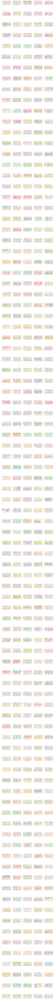

In [42]:
plt.rcParams['figure.figsize'] = [15,300]

for i, item in enumerate(df.listed_items):
    wc.generate(item)

    plt.subplot(93, 5, i+1)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    
plt.show()

In [10]:
new_stop_words = ['data', 'code', 'team']
df['listed_items'] = df.listed_items.apply(lambda x: 
                [item for item in x.split() if item not in new_stop_words])
df['listed_items'] = df.listed_items.str.join(' ')
df.head()

,listed_items
0,develop highly scalable classifiers tools leve...
1,play pivotal role modernize standardize enhanc...
2,act contributing ux designer high visibility f...
3,manage 6 8 technical product managers responsi...
4,leading growing applied scientists solving pro...


### Stemming and Lemmatization

In [11]:
stemmer = SnowballStemmer(language='english')

In [12]:
def description_stemmer(description):
    tokens = description.split()
    stemmed_tokens = [stemmer.stem(token) for token in tokens]
    return ' '.join(stemmed_tokens)

In [13]:
df['listed_items'] = df.listed_items.apply(description_stemmer)
df.head()

,listed_items
0,develop high scalabl classifi tool leverag mac...
1,play pivot role modern standard enhanc peoples...
2,act contribut ux design high visibl fortun 100...
3,manag 6 8 technic product manag respons day da...
4,lead grow appli scientist solv problem zillow ...


ValueError: num must be 1 <= num <= 465, not 466

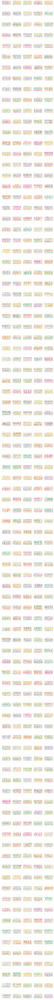

In [15]:
plt.rcParams['figure.figsize'] = [15,300]

for i, item in enumerate(df.listed_items):
    wc.generate(item)

    plt.subplot(93, 5, i+1)
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    
plt.show()